A random split of 50-25-25 might result in a heavily skewed data where some classes would be over or under represented. Hence, splitting classwise would be a better representation of the data as there is an even distribution of samples from every class, reducing bias.

In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, transform

In [2]:
feat_path = 'flowers17feats/flowers17/feats'
feat_list = []
for file in os.listdir(feat_path):
    feat_list.append(np.load(os.path.join(feat_path,file)))

In [3]:
feat_list = np.asarray(feat_list)
print(feat_list)
print(feat_list.shape)

test3 = np.array(1).reshape(1,)
test4 = np.array(2).reshape(1,)
print(test3.shape)
print(feat_list[0].shape)
labelled_features = np.append(feat_list[0], test3, axis = 0)
#print(labelled_features)
print(labelled_features.shape)

labelled_features = np.insert(labelled_features, 0, 1)

labelled_features2 = np.append(feat_list[1], test4, axis = 0)

labelled_features2 = np.insert(labelled_features2, 0, 1)
labelled_data = []
labelled_data.append(labelled_features)
labelled_data.append(labelled_features2)


labelled_data = np.asarray(labelled_data)
print(labelled_data.shape)

labelled_data = np.split(labelled_data, 2)

count = 0
for array in labelled_data:
    print ('count')


[[0.95841885 0.5725309  1.5226848  ... 0.740838   2.5623353  0.91855675]
 [0.46284133 0.21894576 0.30829996 ... 1.623604   2.0692446  0.44727153]
 [0.97899103 0.4820104  0.8356448  ... 0.5713307  1.4354441  0.16059378]
 ...
 [1.2541407  0.15374967 0.6589254  ... 1.6426107  1.2575663  0.21988185]
 [0.6398096  0.19528708 0.33620408 ... 0.4135682  0.4309294  0.58020884]
 [0.89821017 0.6859393  0.6509851  ... 0.90781635 1.536145   1.0174502 ]]
(1360, 512)
(1,)
(512,)
(513,)
(2, 514)
count
count


D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and
D:\Anaconda3\lib\site-packages\matplotlib\axes\_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


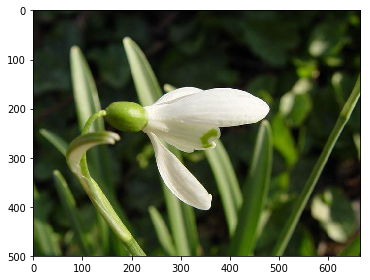

In [4]:
img_path = '17flowers/jpg'
image = io.imshow(io.imread(os.path.join(img_path, 'image_0081.jpg')))
io.show()

In [5]:
# obtain the names of all the images
with open(os.path.join(img_path, 'files.txt'),'r') as fdata:
    imagestr=fdata.read()
img_list = imagestr.split('\n')
print(img_list)

['image_0001.jpg', 'image_0002.jpg', 'image_0003.jpg', 'image_0004.jpg', 'image_0005.jpg', 'image_0006.jpg', 'image_0007.jpg', 'image_0008.jpg', 'image_0009.jpg', 'image_0010.jpg', 'image_0011.jpg', 'image_0012.jpg', 'image_0013.jpg', 'image_0014.jpg', 'image_0015.jpg', 'image_0016.jpg', 'image_0017.jpg', 'image_0018.jpg', 'image_0019.jpg', 'image_0020.jpg', 'image_0021.jpg', 'image_0022.jpg', 'image_0023.jpg', 'image_0024.jpg', 'image_0025.jpg', 'image_0026.jpg', 'image_0027.jpg', 'image_0028.jpg', 'image_0029.jpg', 'image_0030.jpg', 'image_0031.jpg', 'image_0032.jpg', 'image_0033.jpg', 'image_0034.jpg', 'image_0035.jpg', 'image_0036.jpg', 'image_0037.jpg', 'image_0038.jpg', 'image_0039.jpg', 'image_0040.jpg', 'image_0041.jpg', 'image_0042.jpg', 'image_0043.jpg', 'image_0044.jpg', 'image_0045.jpg', 'image_0046.jpg', 'image_0047.jpg', 'image_0048.jpg', 'image_0049.jpg', 'image_0050.jpg', 'image_0051.jpg', 'image_0052.jpg', 'image_0053.jpg', 'image_0054.jpg', 'image_0055.jpg', 'image_00

## Preprocessing of the data to make it easier for later use.

In [6]:
def preprocess_data(img_list):
    label = -1
    preprocessed_data = []
    for i in range(len(img_list)):
        if i % 80 == 0:
            label += 1
            label_feat = np.array(label).reshape(1,) #label feat is just 1....17
        # concate with _ft.npy for features
        ftnpy_name = img_list[i] + '_ft.npy'
        load_feat = np.load(os.path.join(feat_path, ftnpy_name)) # this is the loaded feature
        # Append label and img number to features
        preprocessed_feat = np.append(load_feat, label_feat, axis = 0)
        preprocessed_feat = np.append(preprocessed_feat, np.array(i+1).reshape(1,), axis = 0) 
        preprocessed_data.append(preprocessed_feat)
    
    preprocessed_data = np.asarray(preprocessed_data)
    #print(preprocessed_data.shape)
    
    return preprocessed_data

In [7]:
preprocessed_data = preprocess_data(img_list)

# split the data into 17 classes
preprocessed_data = np.split(preprocessed_data,17)

## Splitting the files into training, validation and test

In [8]:
num_classes = 17
num_per_class = 80
total_imgs = 1360

def datasplit(preprocessed_data, trainsplit,valsplit,testsplit):
    train_data = []
    val_data = []
    test_data = []
    
    total_per_class = trainsplit+valsplit+testsplit
    
    if(num_per_class != total_per_class):
        print("Error, number of samples per class does not equal to training set plus validation set plus test set")
    
    # preprocessed_data is data split by classes
    # classes is the data in one class
    for classes in preprocessed_data:
        np.random.seed(1000)
        np.random.shuffle(classes) #shuffle the class
        
        #appending to train,test,split
        train_data.append(classes[0:trainsplit])
        val_data.append(classes[trainsplit:trainsplit+valsplit])
        test_data.append(classes[trainsplit+valsplit:trainsplit+valsplit+testsplit])

    train_data = np.asarray(train_data)
    val_data = np.asarray(val_data)
    test_data = np.asarray(test_data)
    
    return train_data, val_data, test_data

In [9]:
train_data, val_data, test_data = datasplit(preprocessed_data, 40, 20, 20)
print(train_data.shape, val_data.shape, test_data.shape)

train_data = train_data.reshape(-1, train_data.shape[2])
val_data = val_data.reshape(-1, val_data.shape[2])
test_data = test_data.reshape(-1, test_data.shape[2])

train_data.shape, val_data.shape, test_data.shape

(17, 40, 514) (17, 20, 514) (17, 20, 514)


((680, 514), (340, 514), (340, 514))

In [10]:
#Saving train, validation and test data as .npy files
dataset_path = 'flowersdata/'
np.save(os.path.join(dataset_path, 'train_data.npy'), train_data)
np.save(os.path.join(dataset_path, 'val_data.npy'), val_data)
np.save(os.path.join(dataset_path, 'test_data.npy'), test_data)

In [11]:
train_val_data = np.concatenate((train_data,val_data))
X_train,Y_train = train_data[:,0:-2],train_data[:,-2].astype(int)
X_val,Y_val = val_data[:,0:-2],val_data[:,-2].astype(int)
X_train_val, Y_train_val, imgtrain_idx = train_val_data[:,0:-2],train_val_data[:,-2].astype(int),train_val_data[:,-1].astype(int)

np.random.seed(1000)
np.random.shuffle(test_data)
X_test, Y_test, imgtest_idx = test_data[:,0:-2],test_data[:,-2].astype(int),test_data[:,-1].astype(int)

print(Y_test, imgtest_idx)

[ 5 16 14  2  2 15  1 14 10 15 12  8  8 16 12  1  7 14 10  2 13 16 12  3
  6  8  3 13 10  4  1  9 12  5  7 16 15 16 16  9 13  3 13 14  6 16  6  0
  9 12  7 12 11  6  0  1 13 12  9 13  6 10  9 13 15  4 10 15  2  6  7  4
 15 15 16  8  6  3  5  5  3  1 14  5  4  3  2  9  1  8  6  7  5  1  1  4
  9  5 14 10  5  9 12  3  5 11 14  6 14  6  2  4 13 13  7  5  0 11  8 11
  5 13  3  0 11  4  8  3 11  5 12  1 13  7  6  9 14  6  9 10 10  6 16  8
  1 11 15  2 14 15 12  3  1  1  0 13  8  4 14  2 11  0  3  7  3  1  7  8
  4  2 15 12  5  8  4 11 10 12  3 11  4  8 13  1  8 14  9  6 16  2 11  8
  6 13  0 12 13  7  4  9  0 11 14 16 16  5  0  5  4 15  1 16 10  0  2  8
  0 14 16  7 13 11 10  1 13 15 16 15  6 16  1  3  5 12 10  4  2  4 16 15
  7  9 12 11  4  3  3 11  3 15 16  8 12 12  2  7  4  3 10  5  2  7  1  9
  4 13  0  2 11  7  9  0 10  8 10  5  9  1  2 14  8 11 15  6  2 15  0  4
  6  0  0 13  1  9  7  2  8 15 16  5  7 14  0  9  8 16  7  0  5 14 13 15
  0 10  3  0  6 11 10  7 10 10 12 11 14  7 11 15 14

## training the data based on the test set and validating on the validation set to get best C

In [12]:
from sklearn.model_selection import GridSearchCV
from sklearn.multiclass import OneVsRestClassifier
from sklearn.svm import LinearSVC

In [13]:
C_list = [0.01, 0.1, np.power(0.1, 0.5), 1, np.power(10, 0.5), 10, np.power(100, 0.5)]
score = {}
for C in C_list:
    svc = OneVsRestClassifier(LinearSVC(random_state=1000, C = C))
    svc.fit(X_train,Y_train)
    score[svc.score(X_val,Y_val)]=C
    print('Accuracy of classifier on test set with C = %f: %f'%(C,svc.score(X_val,Y_val)))

print('best C : {}' .format(score[max(score)]))
#      .format(svc.score(X_val, Y_val)))
# cv = [(slice(None), slice(None))]
# clf = GridSearchCV(svc,param_grid = {'estimator__C':[0.01]},cv=cv)
# clf.fit(X_train,Y_train)

Accuracy of classifier on test set with C = 0.010000: 0.923529
Accuracy of classifier on test set with C = 0.100000: 0.923529
Accuracy of classifier on test set with C = 0.316228: 0.926471
Accuracy of classifier on test set with C = 1.000000: 0.923529
Accuracy of classifier on test set with C = 3.162278: 0.920588
Accuracy of classifier on test set with C = 10.000000: 0.920588
Accuracy of classifier on test set with C = 10.000000: 0.920588
best C : 0.31622776601683794


## with the best C, train the data on the training and validation set

In [14]:
C = score[max(score)]
svc = OneVsRestClassifier(LinearSVC(random_state=1000, C = C))
svc.fit(X_train_val,Y_train_val)

OneVsRestClassifier(estimator=LinearSVC(C=0.31622776601683794, class_weight=None, dual=True,
     fit_intercept=True, intercept_scaling=1, loss='squared_hinge',
     max_iter=1000, multi_class='ovr', penalty='l2', random_state=1000,
     tol=0.0001, verbose=0),
          n_jobs=1)

## testing on the Test set

In [15]:
print('Accuracy of classifier on training set: {:.2f}'
     .format(svc.score(X_train_val, Y_train_val)))
print('Accuracy of classifier on test set: {}'
     .format(svc.score(X_test, Y_test)))

#OR
from sklearn.metrics import accuracy_score
Y_pred = svc.predict(X_test)
print('Accuracy of classifier on test set:',accuracy_score(Y_test,Y_pred ))
print(Y_test)
print(Y_pred)

Accuracy of classifier on training set: 1.00
Accuracy of classifier on test set: 0.9264705882352942
Accuracy of classifier on test set: 0.9264705882352942
[ 5 16 14  2  2 15  1 14 10 15 12  8  8 16 12  1  7 14 10  2 13 16 12  3
  6  8  3 13 10  4  1  9 12  5  7 16 15 16 16  9 13  3 13 14  6 16  6  0
  9 12  7 12 11  6  0  1 13 12  9 13  6 10  9 13 15  4 10 15  2  6  7  4
 15 15 16  8  6  3  5  5  3  1 14  5  4  3  2  9  1  8  6  7  5  1  1  4
  9  5 14 10  5  9 12  3  5 11 14  6 14  6  2  4 13 13  7  5  0 11  8 11
  5 13  3  0 11  4  8  3 11  5 12  1 13  7  6  9 14  6  9 10 10  6 16  8
  1 11 15  2 14 15 12  3  1  1  0 13  8  4 14  2 11  0  3  7  3  1  7  8
  4  2 15 12  5  8  4 11 10 12  3 11  4  8 13  1  8 14  9  6 16  2 11  8
  6 13  0 12 13  7  4  9  0 11 14 16 16  5  0  5  4 15  1 16 10  0  2  8
  0 14 16  7 13 11 10  1 13 15 16 15  6 16  1  3  5 12 10  4  2  4 16 15
  7  9 12 11  4  3  3 11  3 15 16  8 12 12  2  7  4  3 10  5  2  7  1  9
  4 13  0  2 11  7  9  0 10  8 10  5  9  1

## obtaining misclassified samples

In [16]:
# misclassify = np.logical_not(Y_test,Y_pred)
# o_r = (np.logical_or(Y_test,Y_pred))
xor = (np.bitwise_xor(Y_test,Y_pred))
# print(np.logical_and(o_r,xor))
# print(o_r)
print(xor)
# print(misclassify)

[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  2
  0  0  0  0  0  7  0  0  0  7  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0 12  0  6  0  0  0  0  0  0  0  0  0  0 10  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 14  0  0  0  0  0  0
  0  3  0  0 15  0  0  0  0  6  0  0  0 10  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  7  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0 10  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 13  5  0  0  0  0  0
  0  0  0  0  0  0  0  0 13  5  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  7  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  7  0  0  0  0  0  1  0 13  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 20 10  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0

In [17]:
def obtain_misclassified(xor):
    misclassified = []
#     idx = 0
    for idx,truth in enumerate(xor):
        if(truth != 0):
            misclassified.append((imgtest_idx[idx],Y_test[idx],Y_pred[idx]))
#         idx += 1
    return misclassified

In [18]:
misclassified = obtain_misclassified(xor)
print(misclassified)



[(286, 3, 1), (398, 4, 3), (441, 5, 2), (601, 7, 11), (958, 11, 13), (1112, 13, 7), (1081, 13, 3), (1042, 13, 14), (922, 11, 4), (442, 5, 3), (606, 7, 13), (62, 0, 7), (1102, 13, 7), (1266, 15, 2), (142, 1, 4), (1086, 13, 0), (1272, 15, 10), (911, 11, 12), (706, 8, 1), (162, 2, 5), (213, 2, 3), (78, 0, 13), (1358, 16, 4), (626, 7, 13), (779, 9, 12)]


## Fail case images

D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and
D:\Anaconda3\lib\site-packages\matplotlib\axes\_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)
D:\Anaconda3\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<function matplotlib.pyplot.show(*args, **kw)>

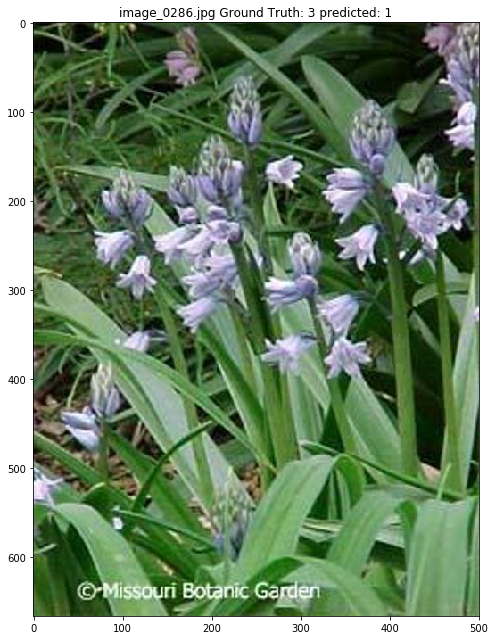

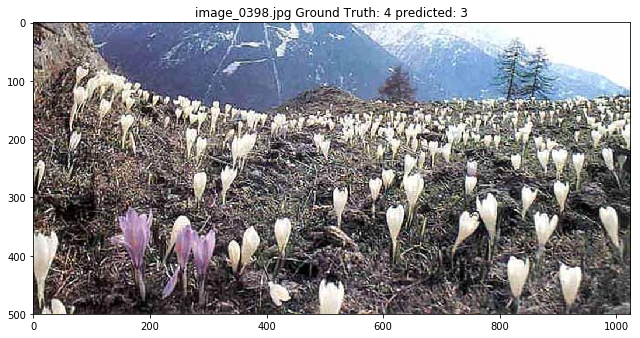

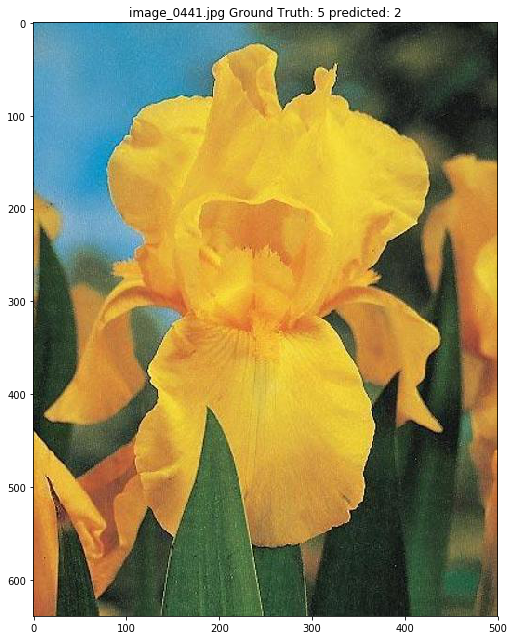

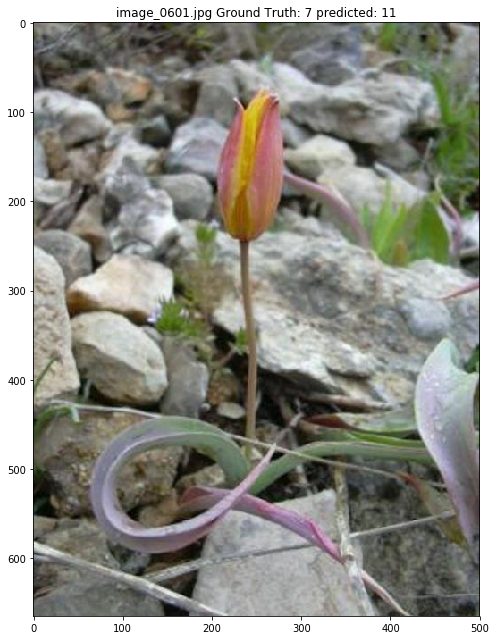

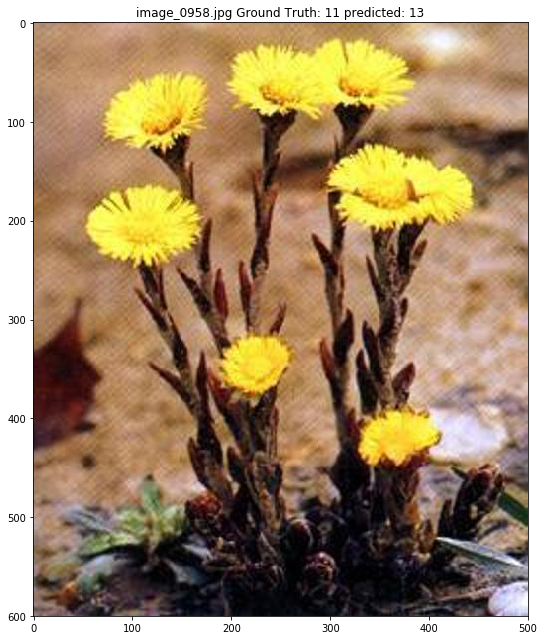

...

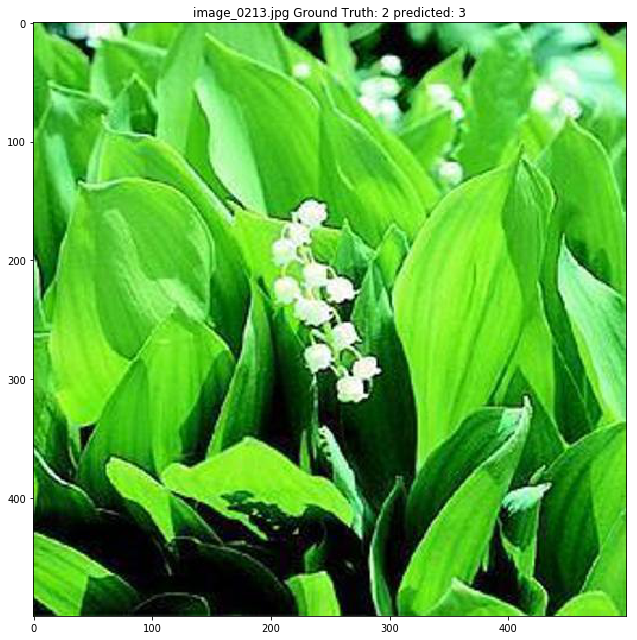

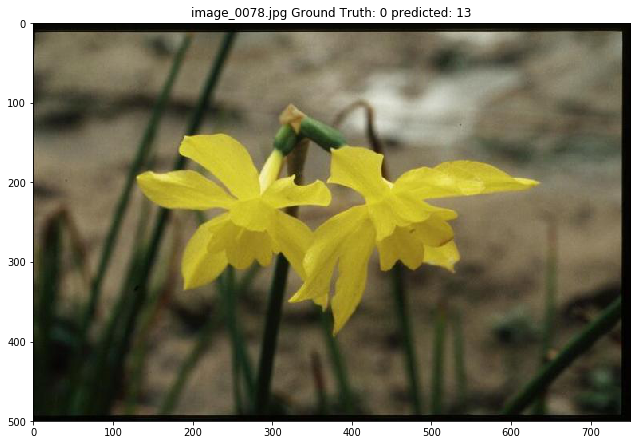

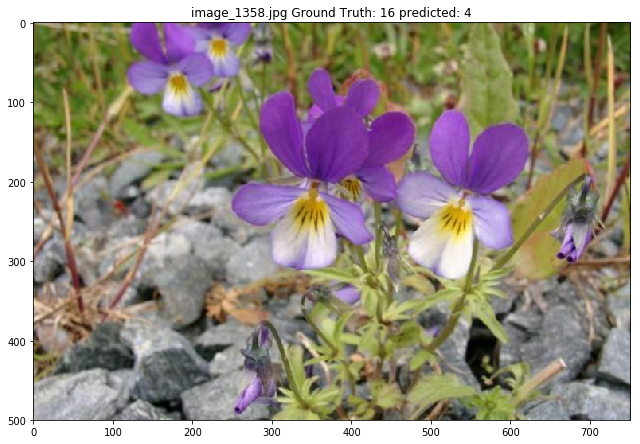

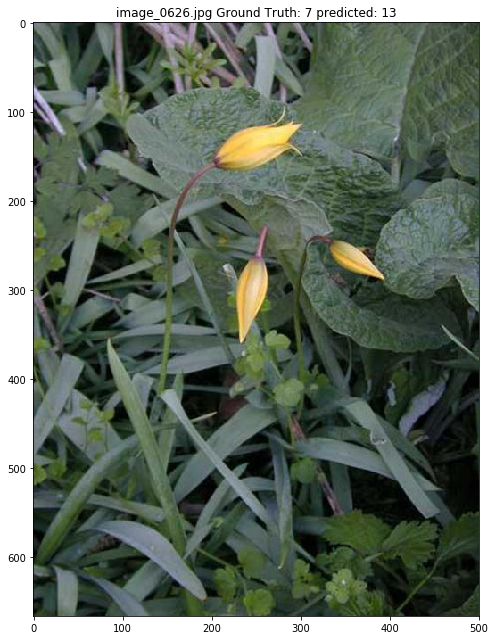

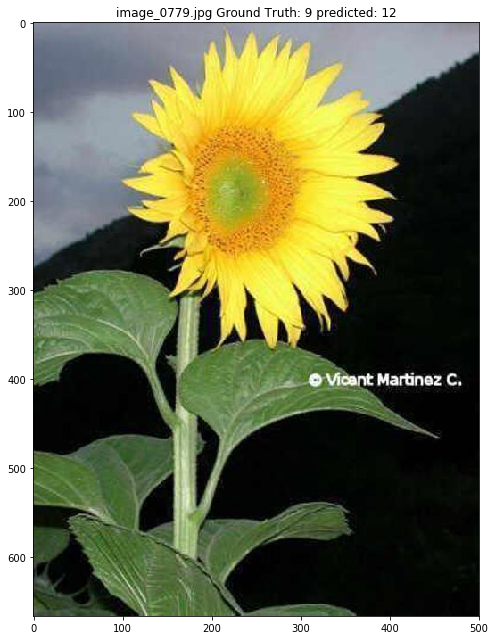

In [19]:
img_path = '17flowers/jpg'

for idx in misclassified:
#     print (idx)
    img_num = ''
    if idx[0] < 10:
        img_num = '000' + str(idx[0])
    elif idx[0] < 100:
        img_num = '00' + str(idx[0])
    elif idx[0] < 1000:
        img_num = '0' + str(idx[0])
    else:
        img_num = str(idx[0])
    img_jpg = 'image_' + img_num +'.jpg'
    fig, ax = plt.subplots(1,1, figsize=(9,9))
    img_title = img_jpg + ' Ground Truth: ' + str(idx[1]) + ' predicted: ' + str(idx[2])
    ax.set_title(img_title)
    image = io.imshow(io.imread(os.path.join(img_path, img_jpg)))
plt.show

# scatterplot = ax.scatter(x_values, y_values, c=Cx1,cmap=matplotlib.colors.ListedColormap(colors),marker = "+")
# ax.set_title('C(x) plot')
# plt.show()
# fig, ax = plt.subplots(1,1, figsize=(9,9))
# plt.scatter(x_values, y_values, c=y_list1, cmap=matplotlib.colors.ListedColormap(colors),marker = "+")
# ax.set_title('y plot')
# plt.show()

## Fail case images limited to 2 and sorted

[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
17


D:\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and
D:\Anaconda3\lib\site-packages\matplotlib\axes\_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


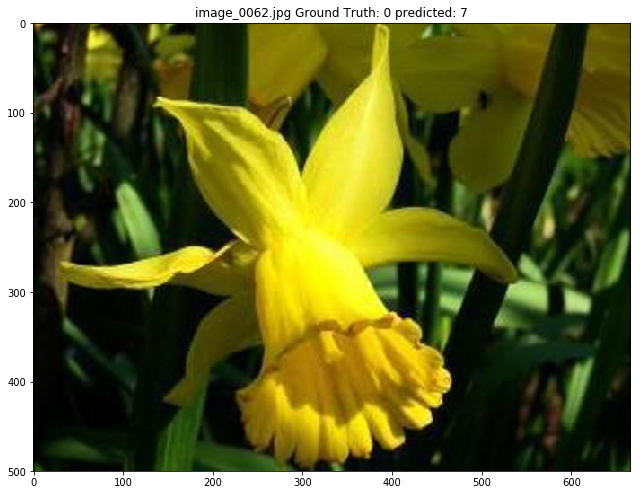

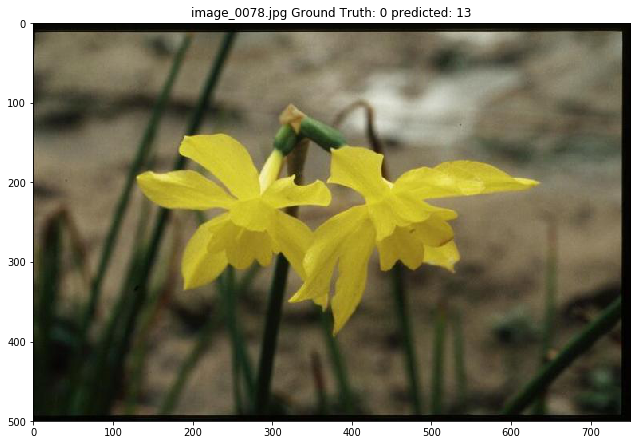

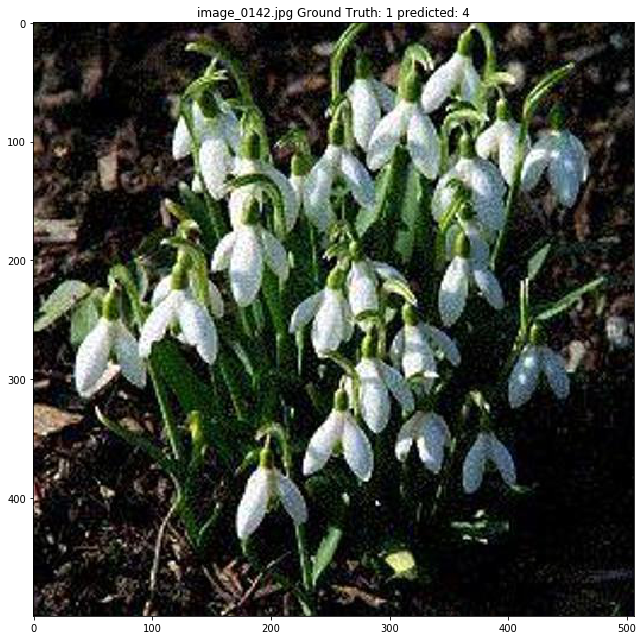

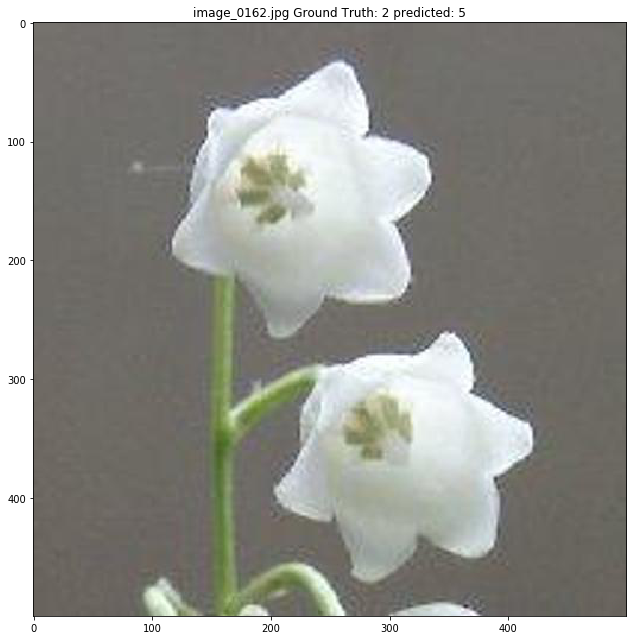

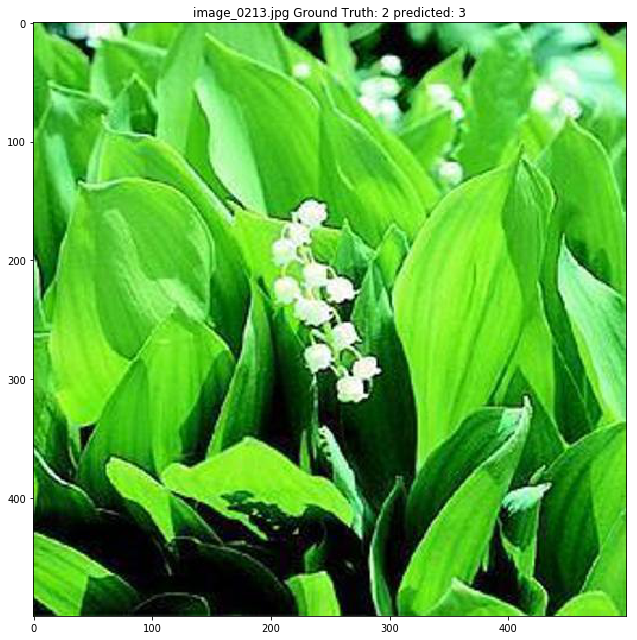

...

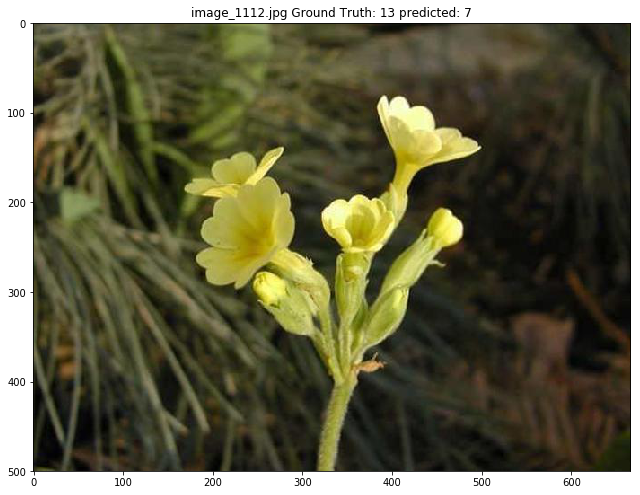

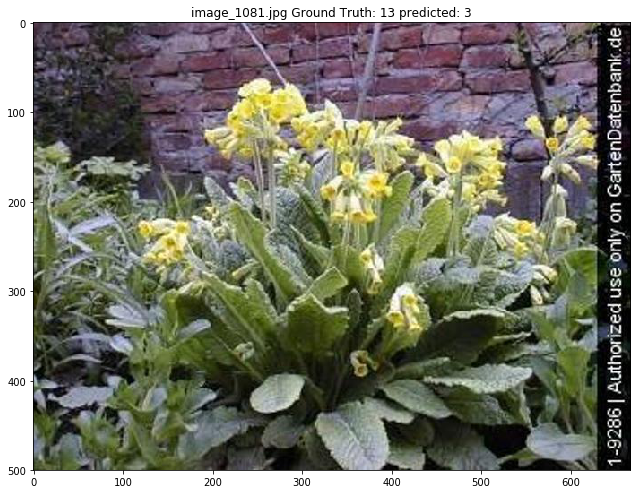

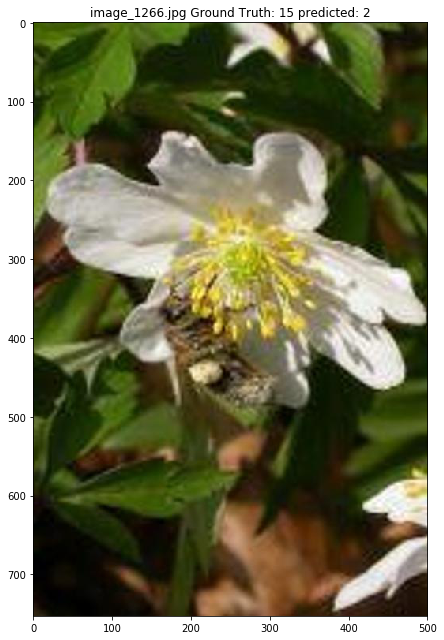

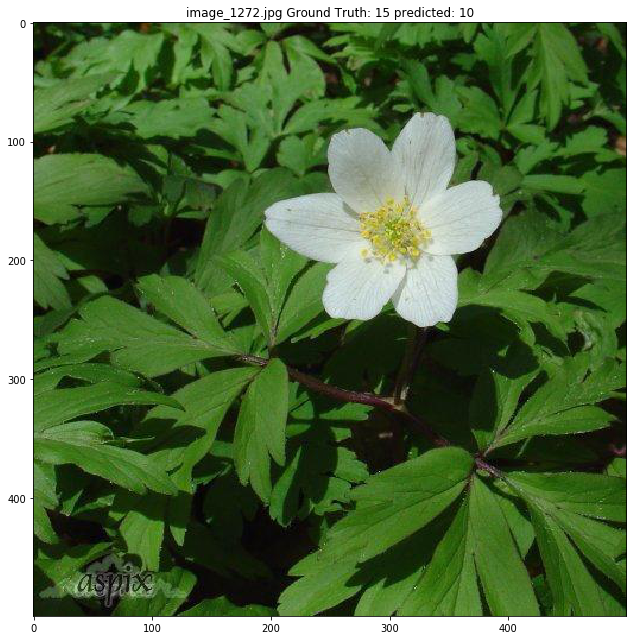

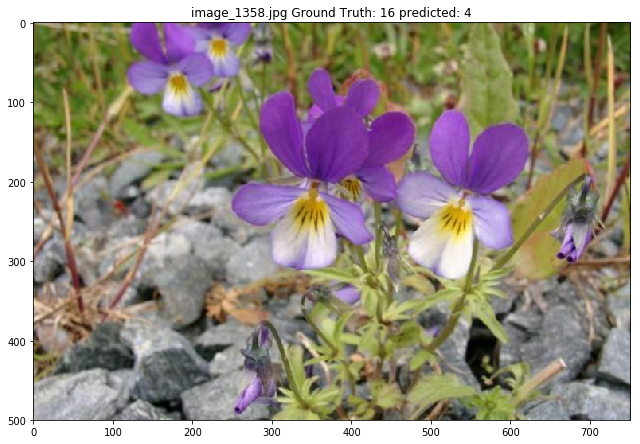

In [36]:
from operator import itemgetter
sorted_misclassified = (sorted(misclassified,key = itemgetter(1)))

limit_ls = []
for i in range(num_classes):
    limit_ls.append(2)
    
print (limit_ls)
print (len(limit_ls))

misclassified_path = 'misclassifieddata'

# idx_prev = 1000
for idx in sorted_misclassified:
#     print (idx)
    limit_ls[idx[1]] -= 1
    if limit_ls[idx[1]] < 0:
        continue  
    img_num = ''
    if idx[0] < 10:
        img_num = '000' + str(idx[0])
    elif idx[0] < 100:
        img_num = '00' + str(idx[0])
    elif idx[0] < 1000:
        img_num = '0' + str(idx[0])
    else:
        img_num = str(idx[0])
    idx_prev = idx[1]
    img_jpg = 'image_' + img_num +'.jpg'
    fig, ax = plt.subplots(1,1, figsize=(9,9))
    img_title = img_jpg + ' Ground Truth: ' + str(idx[1]) + ' predicted: ' + str(idx[2])
    ax.set_title(img_title)
    image = io.imshow(io.imread(os.path.join(img_path, img_jpg)))
# plt.show
